In [1]:
import os
import cv2
import glob
from glob import glob
import math
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from multiprocessing import Pool, cpu_count
from PIL import ImageFilter, ImageStat, Image, ImageDraw
from IPython.display import display

In [2]:
def im_multi(path):
    try:
        #print(path)
        im_stats_im_ = cv2.imread(path)
        #print(im_stats_im_.size)
        return [path, {'size': im_stats_im_.size}]
    except:
        print("Error path:%s"%(path))
        return [path, {'size': [0,0]}]
    
def im_stats(im_stats_df):
    im_stats_d = {}
    p = Pool(cpu_count())
    ret = p.map(im_multi, im_stats_df['path'])
    for i in range(len(ret)):
        im_stats_d[ret[i][0]] = ret[i][1]
    im_stats_df['size'] = im_stats_df['path'].map(lambda x: ' '.join([str(s) for s in str(im_stats_d[x]['size'])]))
    return im_stats_df

In [3]:
basepath = '/home/dataset/train/'

all_cervix_images = []

for path in sorted(glob(basepath + "*")):
    #print(path)
    cervix_type = path.split("/")[-1]
    #print(cervix_type)
    cervix_images = sorted(glob(basepath + cervix_type + "/*"))
    #print(cervix_images)
    all_cervix_images = all_cervix_images + cervix_images

all_cervix_images = pd.DataFrame({'imagepath': all_cervix_images})
all_cervix_images['filetype'] = all_cervix_images.apply(lambda row: row.imagepath.split(".")[-1], axis=1)
all_cervix_images['type'] = all_cervix_images.apply(lambda row: row.imagepath.split("/")[-2], axis=1)
all_cervix_images.head()

,imagepath,filetype,type
0,/home/dataset/train/Type_1/0.jpg,jpg,Type_1
1,/home/dataset/train/Type_1/10.jpg,jpg,Type_1
2,/home/dataset/train/Type_1/1013.jpg,jpg,Type_1
3,/home/dataset/train/Type_1/1014.jpg,jpg,Type_1
4,/home/dataset/train/Type_1/1019.jpg,jpg,Type_1


In [4]:
import glob

In [7]:
import glob
train = glob.glob('/home/dataset/train/**/*.jpg')# + glob.glob('/data/kaggle/additional/**/*.jpg')
train =\
pd.DataFrame([[p.split('/')[3],p.split('/')[4],p] for p in train], columns = ['type','image','path'])#[:40]

In [8]:
# train_ = im_stats(train)
# train_1 = train_[train_['size'] != '0 0'].reset_index(drop=True) #remove bad images

In [7]:
dim = 256

In [8]:
train_data = image_features(train_1['path'], dim)

In [10]:
train_data.shape

(1481, 256, 256, 3)

In [15]:
TRAIN_DATA = "/home/dataset/train"

In [22]:
types = ['Type_1']#,'Type_2','Type_3']
type_ids = []

for type in enumerate(types):
    #print(type)
    type_i_files = glob.glob(os.path.join(TRAIN_DATA, type[1], "*"))
    #print(type_i_files)
    type_i_ids = np.array([s[len(TRAIN_DATA)+8:-4] for s in type_i_files])
    type_ids.append(type_i_ids)

In [37]:
# def get_filename(image_id, image_type):
#     """
#     Method to get image file path from its id and type   
#     """
#     if image_type == "Type_1" or image_type == "Type_2" or image_type == "Type_3":
#         data_path = os.path.join(TRAIN_DATA, image_type)
#     elif image_type == "Test":
#         data_path = TEST_DATA
#     elif image_type == "AType_1" or image_type == "AType_2" or image_type == "AType_3":
#         data_path = os.path.join(ADDITIONAL_DATA, image_type)
#     else:
#         raise Exception("Image type '%s' is not recognized" % image_type)

#     ext = 'jpg'
#     return os.path.join(data_path, "{}.{}".format(image_id, ext))

In [899]:
img = cv2.imread(all_cervix_images['imagepath'][0])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [29]:
def show(X):
    display(Image.fromarray(X))

In [660]:
def cropCircle(img):
    
    if(img.shape[0] > img.shape[1]):
        tile_size = (int(img.shape[1]*256/img.shape[0]), 256)
    else:
        tile_size = (256, int(img.shape[0]*256/img.shape[1]))
    
    print(tile_size)
    img = cv2.resize(img, dsize = tile_size)
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    _, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)
    
    #http://monkeycoding.com/?p=615
    im2, contours, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    main_contour = sorted(contours, key = cv2.contourArea, reverse = True)[0] 
    ff = np.zeros((gray.shape[0], gray.shape[1]), 'uint8') 
    cv2.drawContours(ff, main_contour, -1, (255, 255, 255), 3)
    
    # http://docs.opencv.org/2.4/modules/imgproc/doc/miscellaneous_transformations.html
    ff_mask = np.zeros((gray.shape[0] + 2, gray.shape[1] + 2), 'uint8')
    cv2.floodFill(ff, ff_mask, (int(gray.shape[1]/2), int(gray.shape[0]/2)), 200)
    
#     rect = maxRect(ff)
#     rectangle = [min(rect[0],rect[2]), max(rect[0],rect[2]), min(rect[1],rect[3]), max(rect[1],rect[3])]
#     img_crop = img[rectangle[0]:rectangle[1], rectangle[2]:rectangle[3]]
#     cv2.rectangle(ff,(min(rect[1],rect[3]),min(rect[0],rect[2])),(max(rect[1],rect[3]),max(rect[0],rect[2])),3,2)
    
#     return [img_crop, rectangle, tile_size]
    return ff

In [516]:
img.shape

(3264, 2448, 3)

In [517]:
x = cropCircle(img)#.shape

(192, 256)


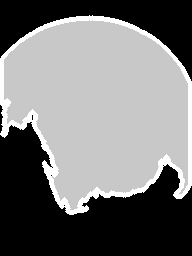

In [466]:
show(x)

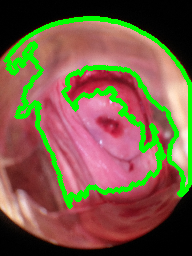

In [82]:
show(cv2.drawContours(x, y, -1, (0, 255, 0), 3))

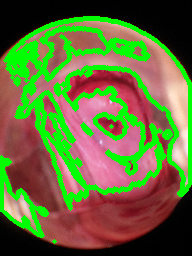

In [83]:
show(cv2.drawContours(x, z, -1, (0, 255, 0), 3))

In [9]:
def maxHist(hist):
    maxArea = (0, 0, 0)
    height = []
    position = []
    for i in range(len(hist)):
        if (len(height) == 0):
            if (hist[i] > 0):
                height.append(hist[i])
                position.append(i)
        else: 
            if (hist[i] > height[-1]):
                height.append(hist[i])
                position.append(i)
            elif (hist[i] < height[-1]):
                while (height[-1] > hist[i]):
                    maxHeight = height.pop()
                    area = maxHeight * (i-position[-1])
                    if (area > maxArea[0]):
                        maxArea = (area, position[-1], i)
                    last_position = position.pop()
                    if (len(height) == 0):
                        break
                position.append(last_position)
                if (len(height) == 0):
                    height.append(hist[i])
                elif(height[-1] < hist[i]):
                    height.append(hist[i])
                else:
                    position.pop()    
    while (len(height) > 0):
        maxHeight = height.pop()
        last_position = position.pop()
        area =  maxHeight * (len(hist) - last_position)
        if (area > maxArea[0]):
            maxArea = (area, len(hist), last_position)
    return maxArea      

In [10]:
def maxRect(img):
    # maxArea[0] : area, maxArea[1] : length of hist, maxArea[2] : last_position
    maxArea = (0, 0, 0)
    addMat = np.zeros(img.shape)
    for r in range(img.shape[0]):
        if r == 0:
            addMat[r] = img[r]
            area = maxHist(addMat[r])
            if area[0] > maxArea[0]:
                maxArea = area + (r,)
        else:
            addMat[r] = img[r] + addMat[r-1]
            addMat[r][img[r] == 0] *= 0
            area = maxHist(addMat[r])
            if area[0] > maxArea[0]:
                maxArea = area + (r,)
    #return (int(maxArea[3] + 1 - maxArea[0]/abs(maxArea[1] - maxArea[2])),\
    #        maxArea[2], maxArea[3], maxArea[1], maxArea[0])
    return (int(maxArea[3] + 1 - (maxArea[0]/abs(maxArea[1] - maxArea[2])/255.)),\
            maxArea[2], maxArea[3], maxArea[1], maxArea[0])

(192, 256)


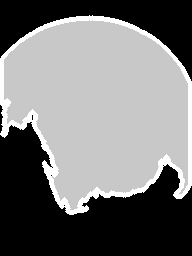

In [483]:
x = cropCircle(img) #.shape
show(x)

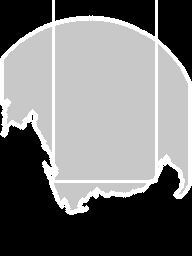

In [498]:
img_2 = cv2.rectangle(x,(min(rect[1],rect[3]),min(rect[0],rect[2])),\
                     (max(rect[1],rect[3]),max(rect[0],rect[2])), 255, 2)
show(img_2)

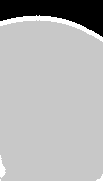

In [482]:
rect = maxRect(x)
rectangle = [min(rect[0],rect[2]), max(rect[0],rect[2]), min(rect[1],rect[3]), max(rect[1],rect[3])]
img_crop = x[rectangle[0] : rectangle[1],\
             rectangle[2] : rectangle[3]]
show(img_crop)

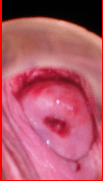

In [562]:
rect = maxRect(x)
rectangle = [min(rect[0],rect[2]), max(rect[0],rect[2]), min(rect[1],rect[3]), max(rect[1],rect[3])]
img_crop = img_[rectangle[0] : rectangle[1],\
             rectangle[2] : rectangle[3]]
show(img_crop)

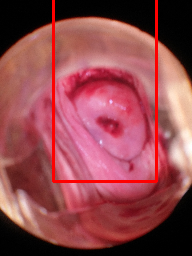

In [481]:
img_ = cv2.resize(img, dsize = (192,256))
img_ = cv2.rectangle(img_,(min(rect[1],rect[3]),min(rect[0],rect[2])),\
                     (max(rect[1],rect[3]),max(rect[0],rect[2])), 255, 2)
show(img_)

In [661]:
xx = cropCircle(img) 

(192, 256)


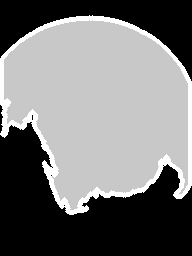

In [662]:
show(xx)

In [708]:
show(xx[:20])

In [706]:
img = xx

In [709]:
maxArea = (0, 0, 0) 
# 最後會變成四維度
# 第一個存面積
# 第二個存起始hist大於0位置
# 第三個存最後一個hist小於前一個高的位置
# 第四個存row
addMat = np.zeros(img.shape)

for r in range(img.shape[0]):
    if r == 0:
        addMat[r] = img[r]
        #print(addMat[r])
        area = maxHist(addMat[r])
        print(area)
        if area[0] > maxArea[0]:
            maxArea = area + (r,) # r : row index
    else:
        addMat[r] = img[r] + addMat[r-1] # 疊加上一個 row，讓判斷是否為最大長方形
        addMat[r][img[r] == 0] *= 0
        area = maxHist(addMat[r])
        print(area)
        if area[0] > maxArea[0]:
            maxArea = area + (r,)

(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(0, 0, 0)
(255.0, 89, 90)
(7140.0, 76, 104)
(14280.0, 76, 104)
(21420.0, 76, 104)
(31365.0, 69, 110)
(41820.0, 69, 110)
(52275.0, 69, 110)
(65025.0, 64, 115)
(75225.0, 64, 115)
(87025.0, 60, 119)
(98825.0, 60, 119)
(110625.0, 60, 119)
(123750.0, 56, 122)
(136950.0, 56, 122)
(150150.0, 56, 122)
(163800.0, 53, 125)
(178200.0, 53, 125)
(193050.0, 50, 128)
(208650.0, 50, 128)
(224250.0, 50, 128)
(239850.0, 50, 128)
(255875.0, 44, 133)
(273675.0, 44, 133)
(291475.0, 44, 133)
(309275.0, 44, 133)
(327075.0, 44, 133)
(344875.0, 44, 133)
(362675.0, 44, 133)
(380475.0, 44, 133)
(398275.0, 44, 133)
(416075.0, 44, 133)
(434075.0, 40, 137)
(453475.0, 40, 137)
(472875.0, 40, 137)
(492375.0, 38, 139)
(512575.0, 38, 139)
(532775.0, 38, 139)
(552975.0, 38, 139)
(573175.0, 38, 139)
(593375.0, 38, 139)
(613575.0, 38, 139)
(635600.0, 33, 145)
(658000.0, 33, 145)
(6804

In [11]:
def maxHist(hist):
    maxArea = (0, 0, 0)
    height = [] # 尋找  Rectangle 的高度
    position = []
    #print(len(hist))
    
    for i in range(len(hist)):
        
        #print(len(height), hist[i], height)
        
        if (len(height) == 0):
            if (hist[i] > 0):
                
                height.append(hist[i])
                position.append(i)
        else: 
            #print(i, height, hist[i] , position)
            #print(hist[i] > height[-1], hist[i] < height[-1])
            
            if (hist[i] > height[-1]):
                # 高度增加
                height.append(hist[i])
                position.append(i)
                
            elif (hist[i] < height[-1]):
                # 高度降低
                while (height[-1] > hist[i]):
                    
                    maxHeight = height.pop() # 把最後一個高度取出來
                    #print(maxHeight)
                    area = maxHeight * (i - position[-1]) # 計算面積
                    
                    if (area > maxArea[0]):
                        maxArea = (area, position[-1], i)
                    last_position = position.pop() # 把前面高度上升時的位置記錄下來
                    
                    if (len(height) == 0): 
                        break
                        
                position.append(last_position)
                
                if (len(height) == 0):
                    height.append(hist[i])
                elif(height[-1] < hist[i]):
                    height.append(hist[i])
                else:
                    position.pop()   
                    
    while (len(height) > 0):
        
        maxHeight = height.pop()
        last_position = position.pop()
        area =  maxHeight * (len(hist) - last_position)
        if (area > maxArea[0]):
            maxArea = (area, len(hist), last_position)
            
    return maxArea      

In [82]:
def cropCircle(img, resize):
    
    if(img.shape[0] > img.shape[1]):
        tile_size = (int(img.shape[1]*256/img.shape[0]), 256)
    else:
        tile_size = (256, int(img.shape[0]*256/img.shape[1]))
    #tile_size = (img.shape[0], img.shape[1])
    
    img = cv2.resize(img, dsize = tile_size)
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    _, thresh = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY)
    
    #http://monkeycoding.com/?p=615
    im2, contours, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    main_contour = sorted(contours, key = cv2.contourArea, reverse = True)[0] 
    ff = np.zeros((gray.shape[0], gray.shape[1]), 'uint8') 
    cv2.drawContours(ff, main_contour, -1, (255, 255, 255), 3)
    
    # http://docs.opencv.org/2.4/modules/imgproc/doc/miscellaneous_transformations.html
    ff_mask = np.zeros((gray.shape[0] + 2, gray.shape[1] + 2), 'uint8')
    cv2.floodFill(ff, ff_mask, (int(gray.shape[1]/2), int(gray.shape[0]/2)), 200)
    
    rect = maxRect(ff)
    rectangle = [min(rect[0], rect[2]), max(rect[0], rect[2]),\
                 min(rect[1], rect[3]), max(rect[1], rect[3])]
    img_crop = img[rectangle[0]:rectangle[1], rectangle[2]:rectangle[3]]
    cv2.rectangle(ff,(min(rect[1],rect[3]),min(rect[0],rect[2])),(max(rect[1],rect[3]),max(rect[0],rect[2])),3,2)
    
    img_ = cv2.rectangle(img, (min(rect[1],rect[3]),
                             min(rect[0],rect[2])),
                        (max(rect[1],rect[3]),
                         max(rect[0],rect[2])), 255, 2)
    img_nocrop_r =  cv2.resize(img_, dsize = (resize, resize))
    img_crop_r =  cv2.resize(img_crop, dsize = (resize, resize))
    
    return img_crop_r, img_nocrop_r#, rectangle, tile_size]

In [947]:
dim = 64
x = cropCircle(img, dim) #.shape

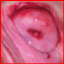

In [948]:
show(x[0])

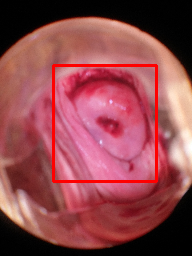

In [945]:
show(x[-1])

In [920]:
# def Ra_space(img, Ra_ratio, a_threshold):
#     imgLab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB);
#     w = img.shape[0]
#     h = img.shape[1]
#     Ra = np.zeros((w*h, 2))
#     for i in range(w):
#         for j in range(h):
#             R = math.sqrt((w/2-i)*(w/2-i) + (h/2-j)*(h/2-j))
#             Ra[i*h+j, 0] = R
#             Ra[i*h+j, 1] = min(imgLab[i][j][1], a_threshold)
            
#     Ra[:,0] /= max(Ra[:,0])
#     Ra[:,0] *= Ra_ratio
#     Ra[:,1] /= max(Ra[:,1])

#     return Ra

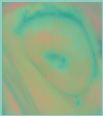

In [905]:
show(cv2.cvtColor(x[0], cv2.COLOR_RGB2LAB))

In [906]:
Ra_space(x[0], 1.0, 150).shape

(11948, 2)

In [907]:
w = x[0].shape[0]
h = x[0].shape[1]

In [908]:
Ra_space(x[0], 1.0, 150)[:,1]

array([ 1.,  1.,  1., ...,  1.,  1.,  1.])

In [909]:
np.reshape(Ra_space(x[0], 1.0, 150)[:,1], (w,h)).shape

(116, 103)

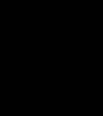

In [914]:
show(np.reshape(Ra_space(x[0], 1.0, 150)[:,1], (w,h)).astype("uint8"))

In [ ]:
def SEG_PAPER():

In [28]:
# def get_and_crop_image(image_id, image_type):
    
#     img = get_image_data(image_id, image_type)
#     initial_shape = img.shape
#     [img, rectangle_cropCircle, tile_size] = cropCircle(img)
    
#     imgLab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB);
#     w = img.shape[0]
#     h = img.shape[1]
#     Ra = Ra_space(imgLab, 1.0, 150)
#     a_channel = np.reshape(Ra[:,1], (w,h))
    
#     g = mixture.GaussianMixture(n_components = 2, covariance_type = 'diag',
#                                 random_state = 0, init_params = 'kmeans')
    
#     image_array_sample = shuffle(Ra, random_state=0)[:1000]
#     g.fit(image_array_sample)
#     labels = g.predict(Ra)
#     labels += 1 # Add 1 to avoid labeling as 0 since regionprops ignores the 0-label.
    
#     # The cluster that has the highest a-mean is selected.
#     labels_2D = np.reshape(labels, (w,h))
#     gg_labels_regions = measure.regionprops(labels_2D, intensity_image = a_channel)
#     gg_intensity = [prop.mean_intensity for prop in gg_labels_regions]
#     cervix_cluster = gg_intensity.index(max(gg_intensity)) + 1

#     mask = np.zeros((w * h,1),'uint8')
#     mask[labels == cervix_cluster] = 255
#     mask_2D = np.reshape(mask, (w,h))

#     cc_labels = measure.label(mask_2D, background=0)
#     regions = measure.regionprops(cc_labels)
#     areas = [prop.area for prop in regions]

#     regions_label = [prop.label for prop in regions]
#     largestCC_label = regions_label[areas.index(max(areas))]
#     mask_largestCC = np.zeros((w,h), 'uint8')
#     mask_largestCC[cc_labels==largestCC_label] = 255

#     img_masked = img.copy()
#     img_masked[mask_largestCC==0] = (0, 0, 0)
#     img_masked_gray = cv2.cvtColor(img_masked, cv2.COLOR_RGB2GRAY);
            
#     _,thresh_mask = cv2.threshold(img_masked_gray,0,255,0)
            
#     kernel = np.ones((11,11), np.uint8)
#     thresh_mask = cv2.dilate(thresh_mask, kernel, iterations = 1)
#     thresh_mask = cv2.erode(thresh_mask, kernel, iterations = 2)
#     _, contours_mask, _ = cv2.findContours(thresh_mask.copy(), cv2.RETR_TREE,cv2.CHAIN_APPROX_NONE)

#     main_contour = sorted(contours_mask, key = cv2.contourArea, reverse = True)[0]
#     cv2.drawContours(img, main_contour, -1, 255, 3)
    
#     x,y,w,h = cv2.boundingRect(main_contour)
    
#     rectangle = [x+rectangle_cropCircle[2],
#                  y+rectangle_cropCircle[0],
#                  w,
#                  h,
#                  initial_shape[0],
#                  initial_shape[1],
#                  tile_size[0],
#                  tile_size[1]]

#     return [image_id, img, rectangle]

In [15]:
import glob

In [18]:
basepath = '/home/dataset/train/'

all_cervix_images = []

for path in sorted(glob.glob(basepath + "*")):
    #print(path)
    cervix_type = path.split("/")[-1]
    #print(cervix_type)
    cervix_images = sorted(glob.glob(basepath + cervix_type + "/*"))
    #print(cervix_images)
    all_cervix_images = all_cervix_images + cervix_images

all_cervix_images = pd.DataFrame({'imagepath': all_cervix_images})
all_cervix_images['filetype'] = all_cervix_images.apply(lambda row: row.imagepath.split(".")[-1], axis=1)
all_cervix_images['type'] = all_cervix_images.apply(lambda row: row.imagepath.split("/")[-2], axis=1)
all_cervix_images.head()

,imagepath,filetype,type
0,/home/dataset/train/Type_1/0.jpg,jpg,Type_1
1,/home/dataset/train/Type_1/10.jpg,jpg,Type_1
2,/home/dataset/train/Type_1/1013.jpg,jpg,Type_1
3,/home/dataset/train/Type_1/1014.jpg,jpg,Type_1
4,/home/dataset/train/Type_1/1019.jpg,jpg,Type_1


In [19]:
train = glob.glob('/home/dataset/train/**/*.jpg')# + glob.glob('/data/kaggle/additional/**/*.jpg')
train =\
pd.DataFrame([[p.split('/')[3],p.split('/')[4],p] for p in train], columns = ['type','image','path'])#[:40]

In [20]:
train_ = im_stats(train)
train_1 = train_[train_['size'] != '0 0'].reset_index(drop=True) #remove bad images

In [52]:
def get_im_cv2(args):
    
    img = cv2.imread(args[0])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    crop_resized, nocrop_resized = cropCircle(img, args[1])
    
    return [args[0], crop_resized, nocrop_resized]

In [83]:
def image_features(paths, dim):
    
    imf_d1 = {}
    imf_d2 = {}
    p = Pool(cpu_count())
    dims = [dim for i in range(len(paths.tolist()))]
    params = list(zip(paths.tolist(), dims))
    ret = p.map(get_im_cv2, params)
    #print(ret)
    
    for i in range(len(ret)):
        imf_d1[ret[i][0]] = ret[i][1]
        
    for i in range(len(ret)):
        imf_d2[ret[i][0]] = ret[i][2]
        
    ret = []
    fdata1 = [imf_d1[f] for f in paths]
    fdata1 = np.array(fdata1, dtype = np.uint8)
    
    fdata2 = [imf_d2[f] for f in paths]
    fdata2 = np.array(fdata2, dtype = np.uint8)
    
    return fdata1, fdata2

In [23]:
train_1['path'][0]

'/home/dataset/train/Type_3/477.jpg'

In [74]:
dim = 256

In [90]:
train_data1, train_data2 = image_features(train_1['path'], dim)

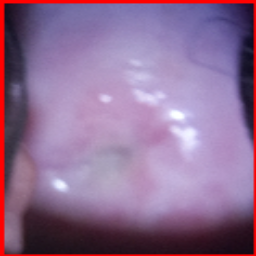

In [86]:
show(train_data1[4])

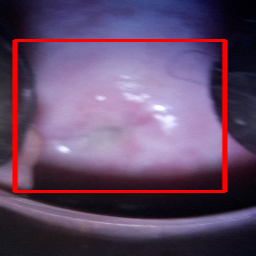

In [87]:
show(train_data2[4])

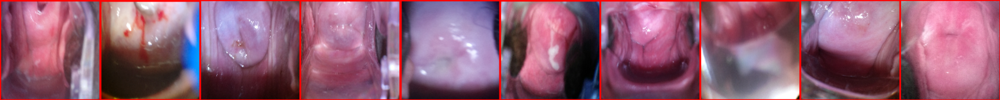

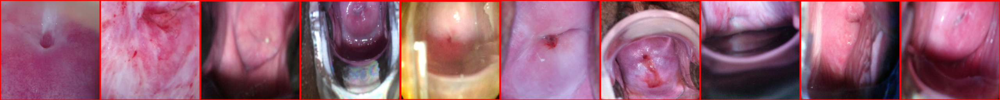

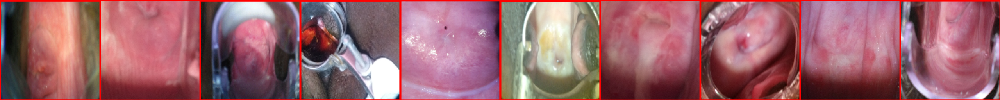

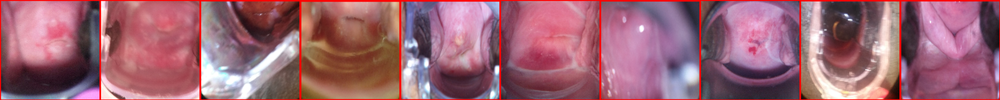

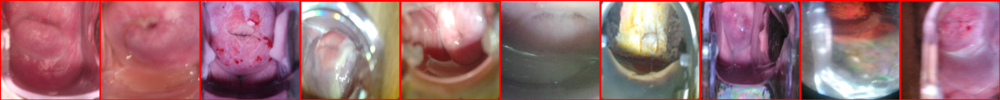

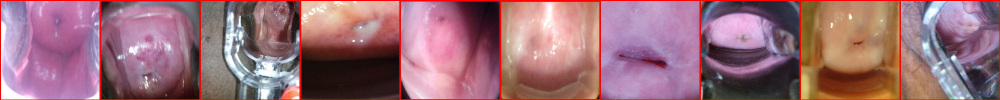

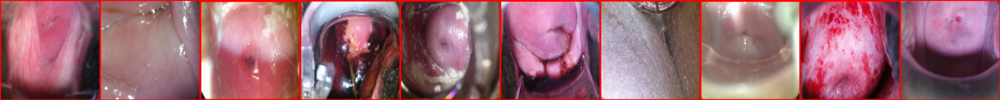

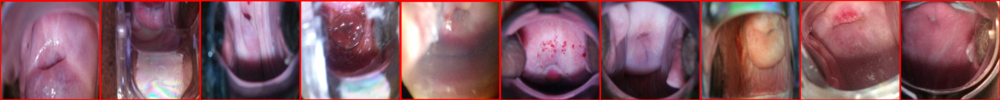

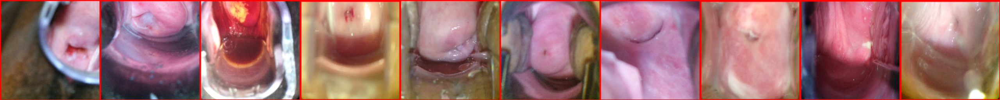

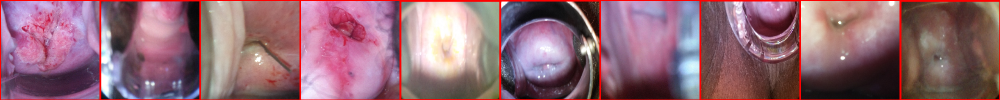

In [88]:
for i in range(0,100,10):
    show(train_data1[i:i+10].reshape(-1,dim,dim,3).swapaxes(0,1).reshape(dim,-1,3))

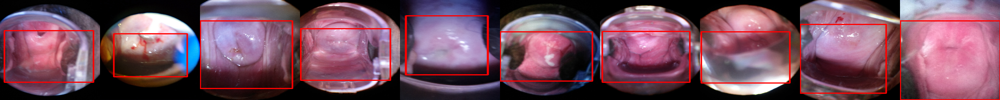

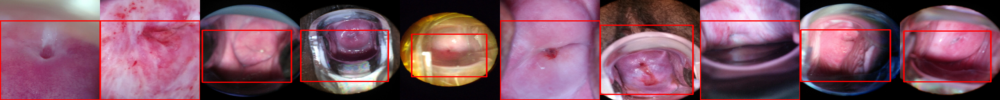

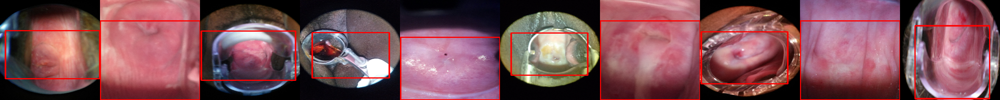

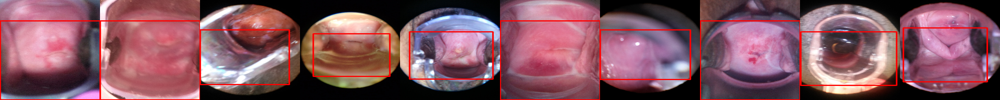

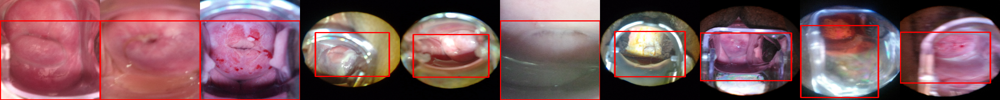

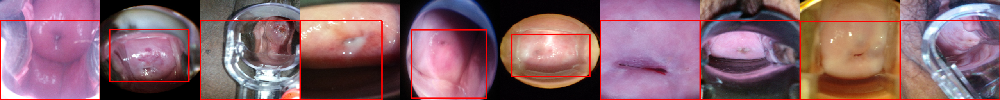

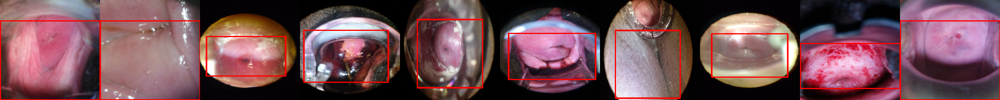

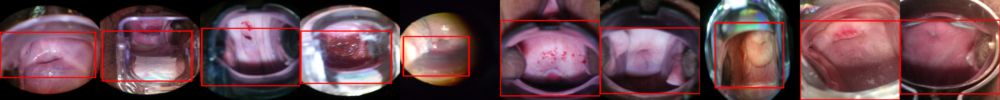

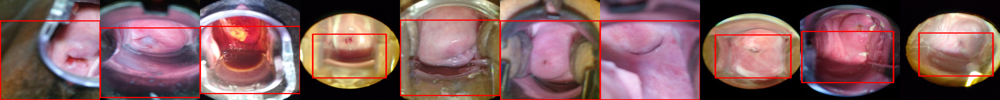

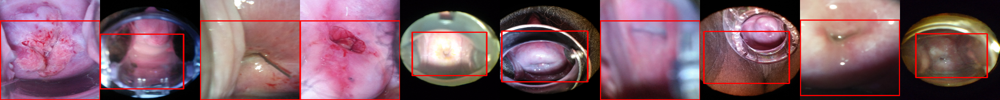

In [89]:
for i in range(0,100,10):
    show(train_data2[i:i+10].reshape(-1,dim,dim,3).swapaxes(0,1).reshape(dim,-1,3))